# **LoG и DoG-методы детектирования границ**

In [69]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [70]:
def gaussian_kernel(size, sigma=1.0):
    size = int(size) // 2
    x, y = np.mgrid[-size:size + 1, -size:size + 1]
    normal = 1 / (2.0 * np.pi * sigma ** 2)
    g = np.exp(-((x ** 2 + y ** 2) / (2.0 * sigma ** 2))) * normal
    return g

In [71]:
def convolve2d(image, kernel):
    kernel_height, kernel_width = kernel.shape
    pad_height = kernel_height // 2
    pad_width = kernel_width // 2

    padded_image = np.zeros((image.shape[0] + pad_height * 2, image.shape[1] + pad_width * 2))
    padded_image[pad_height:padded_image.shape[0] - pad_height, pad_width:padded_image.shape[1] - pad_width] = image

    convolved = np.zeros(image.shape)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            convolved[i, j] = np.sum(kernel * padded_image[i:i + kernel_height, j:j + kernel_width])

    return convolved

In [72]:
def laplacian_of_gaussian(image, kernel_size=5, sigma=1.0):
    gaussian_k = gaussian_kernel(kernel_size, sigma)
    smoothed_image = convolve2d(image, gaussian_k)
    laplacian_k = np.array([[0, 1, 0],
                            [1, -4, 1],
                            [0, 1, 0]])
    return convolve2d(smoothed_image, laplacian_k)

In [73]:
def difference_of_gaussians(image, kernel_size=5, sigma=1.0, k=1.6):
    gaussian_k1 = gaussian_kernel(kernel_size, sigma)
    gaussian_k2 = gaussian_kernel(kernel_size, sigma * k)
    gaussian1 = convolve2d(image, gaussian_k1)
    gaussian2 = convolve2d(image, gaussian_k2)
    return gaussian1 - gaussian2

In [85]:
def show_images(images, titles):
    n = len(images)
    fig, axes = plt.subplots(1, n, figsize=(20, 10))
    if n == 1:
        axes = [axes]
    for ax, image, title in zip(axes, images, titles):
        ax.imshow(image, cmap='gray')
        ax.set_title(title)
        ax.axis('off')
    plt.show()

In [99]:
img_path = '../assets/cars.jpg'
img = np.asarray(Image.open(img_path).convert('L'))
gaussian_kernel(3, 1)

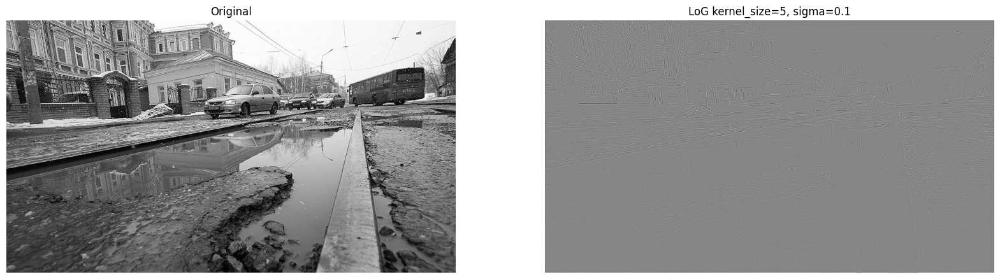

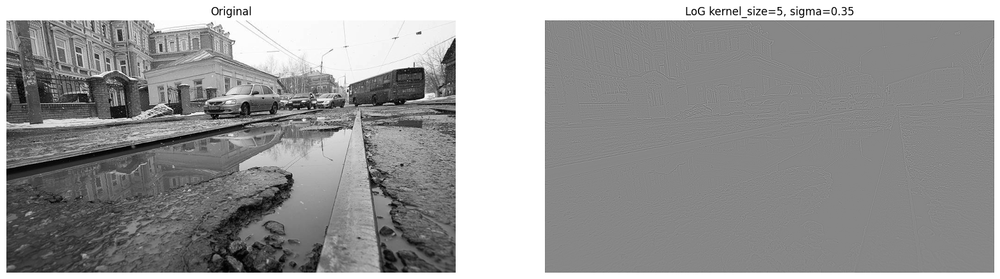

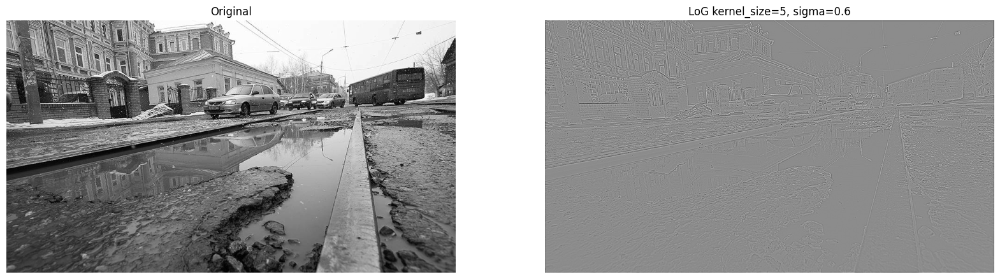

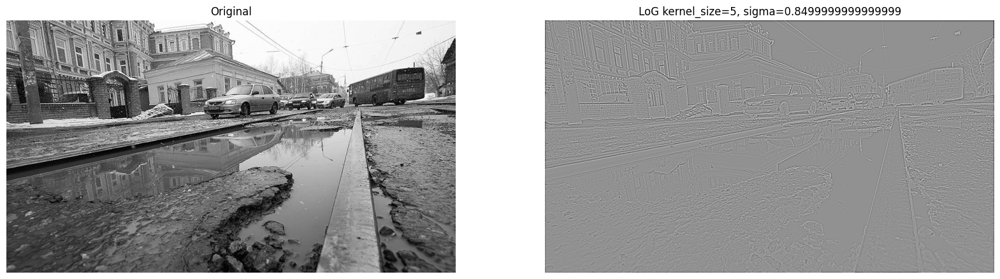

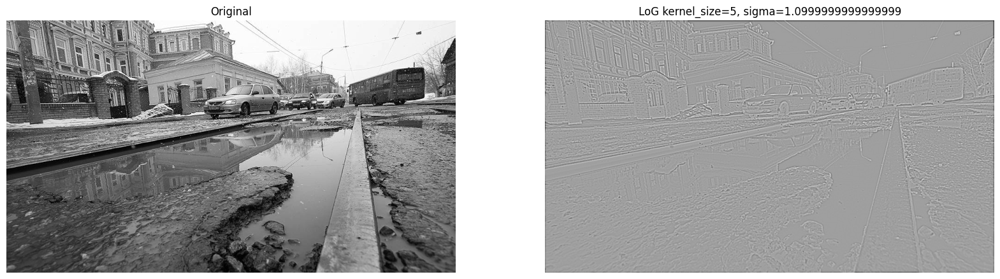

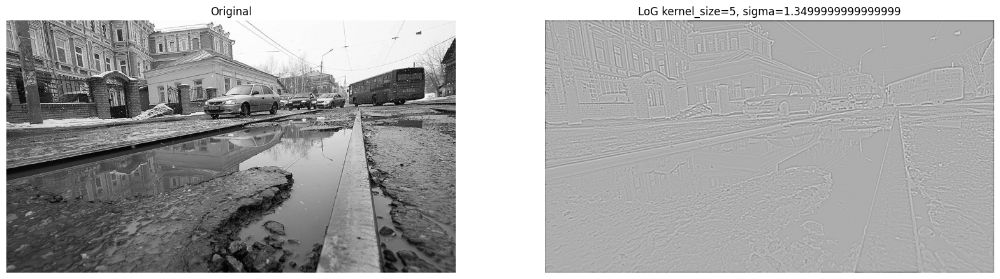

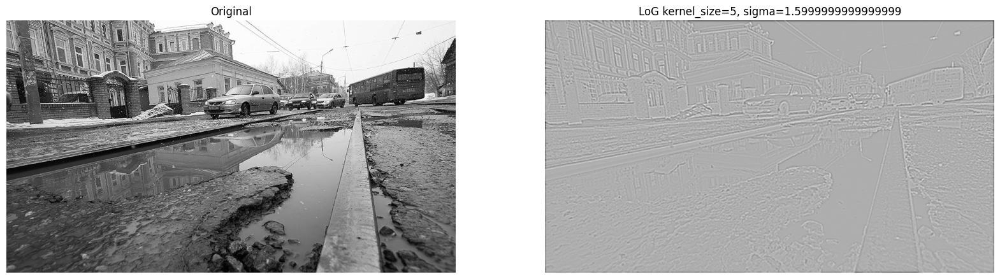

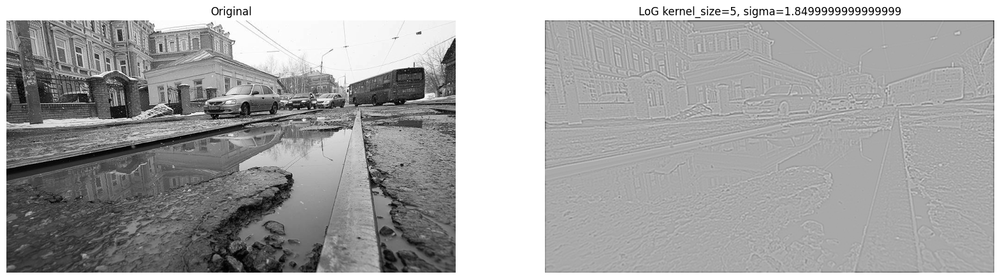

In [100]:
for sigma in np.arange(0.1, 2.1, 0.25):
    log_image = laplacian_of_gaussian(img, sigma=sigma)
    show_images([img, log_image], ['Original', f'LoG kernel_size=5, sigma={sigma}'])

LoG при sigma 1.09 уже почти не меняется, поэтому это оптимальное значение для текущего изображения

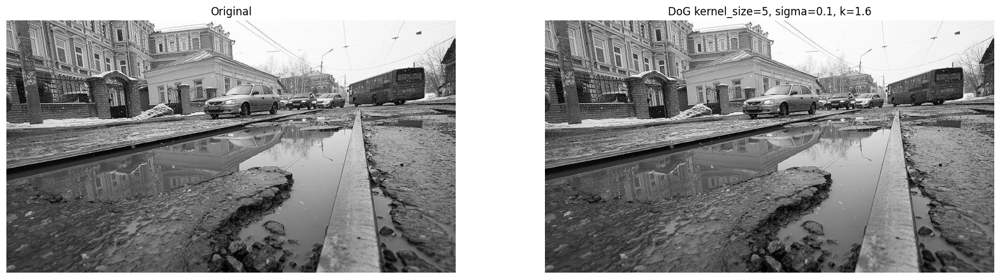

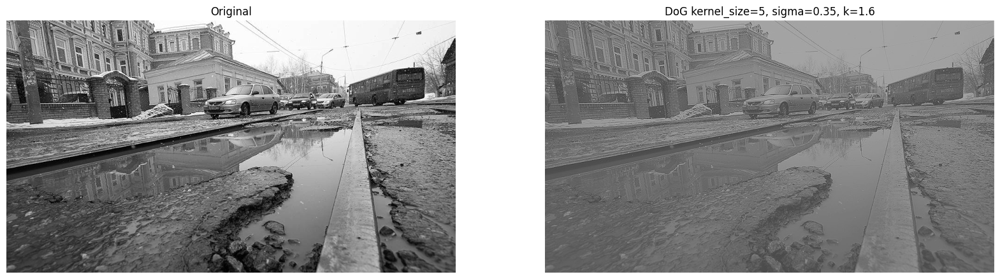

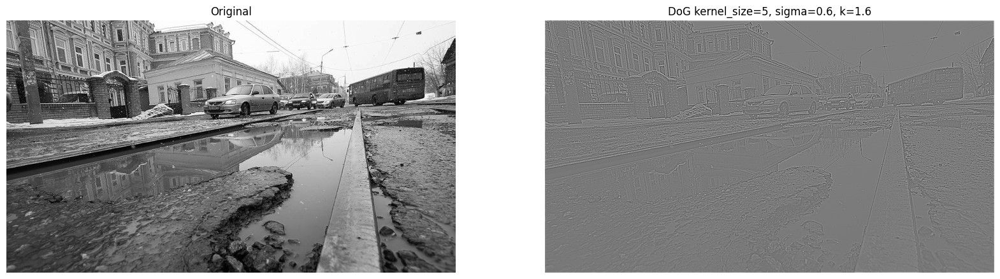

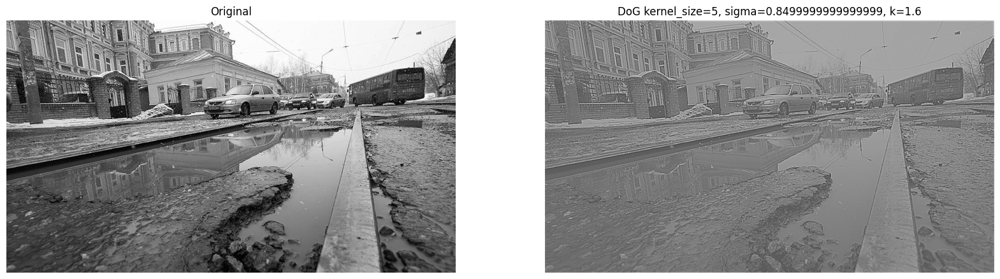

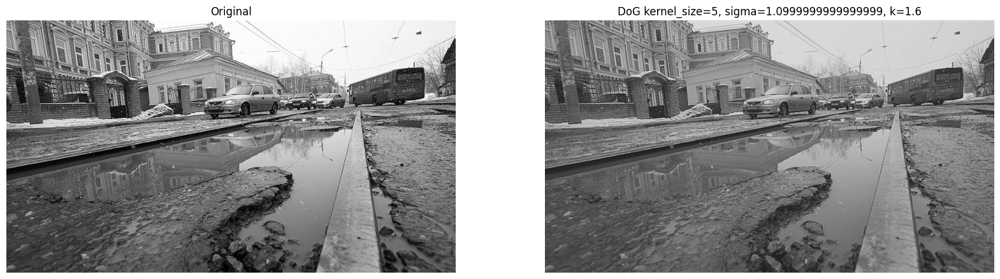

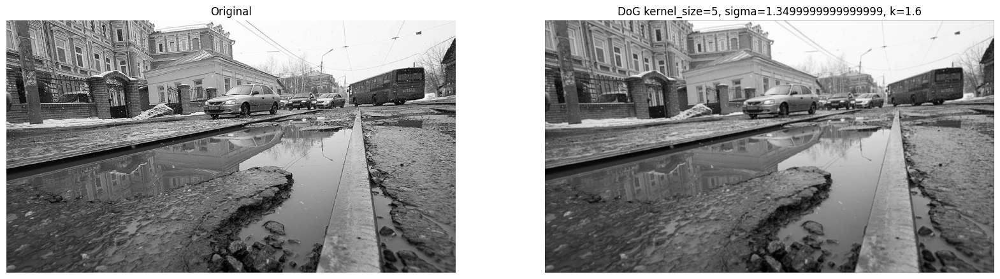

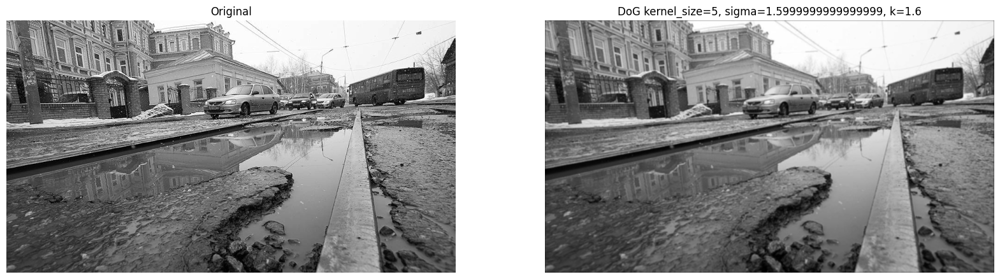

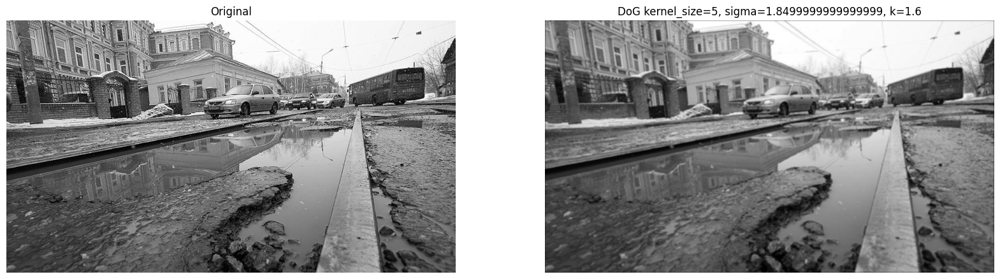

In [101]:
for sigma in np.arange(0.1, 2.1, 0.25):
    dog_image = difference_of_gaussians(img, sigma=sigma)
    show_images([img, dog_image], ['Original', f'DoG kernel_size=5, sigma={sigma}, k=1.6'])

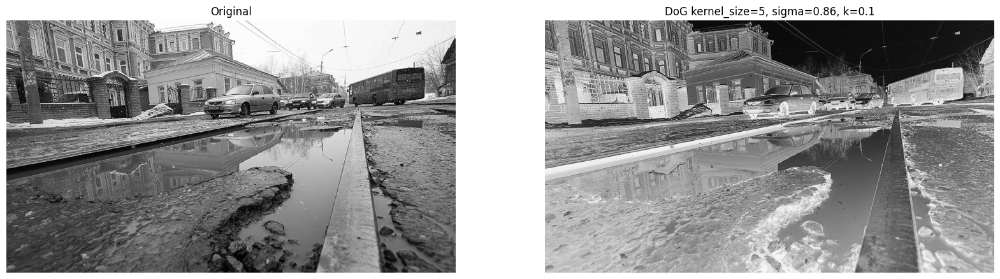

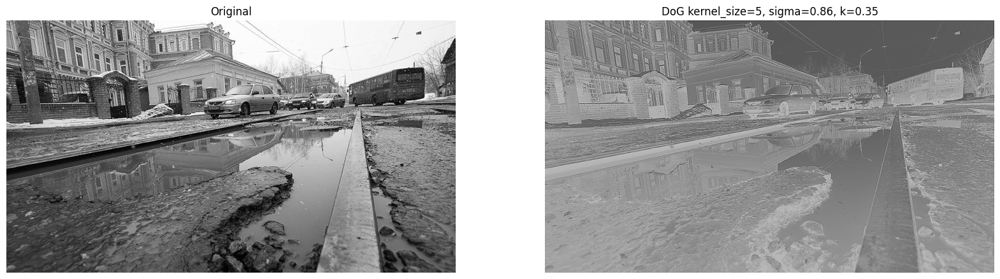

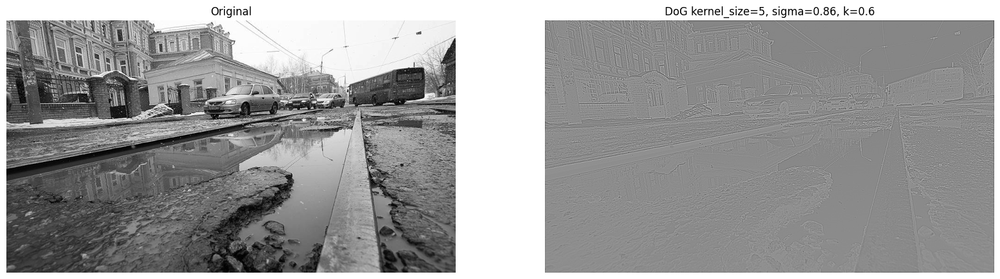

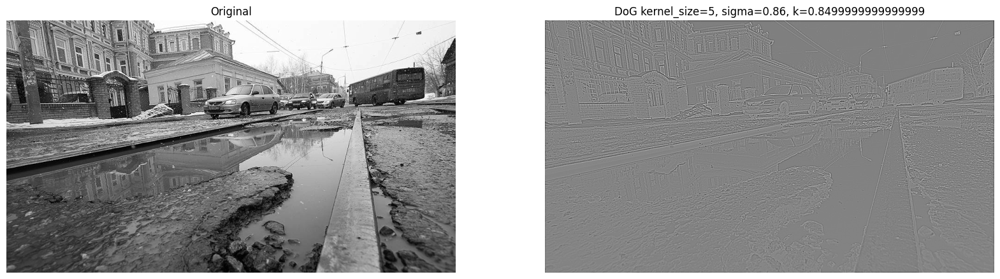

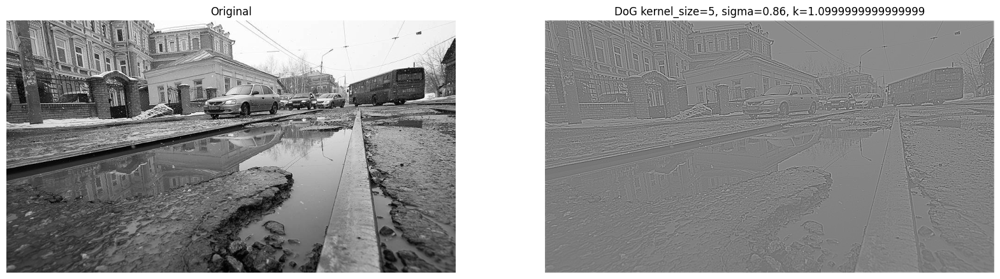

...

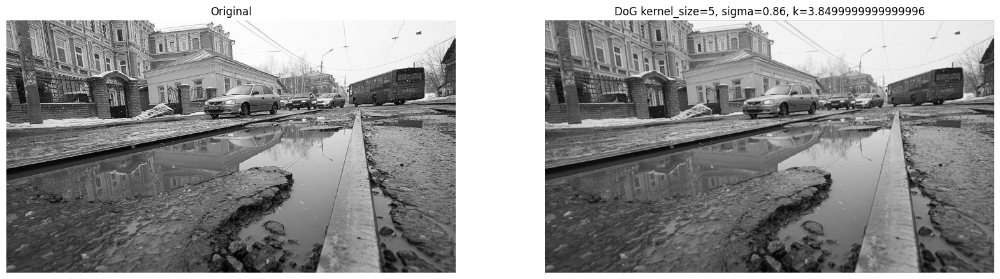

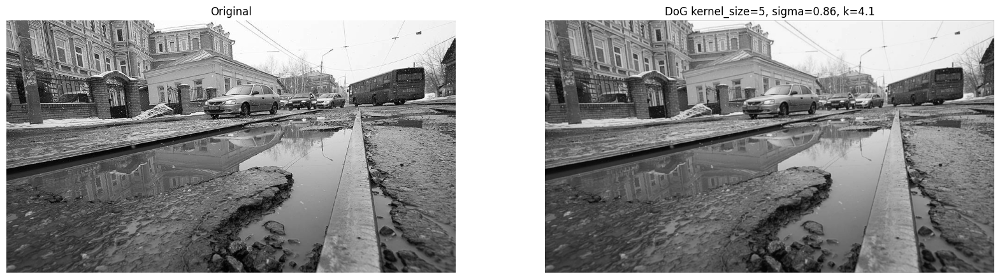

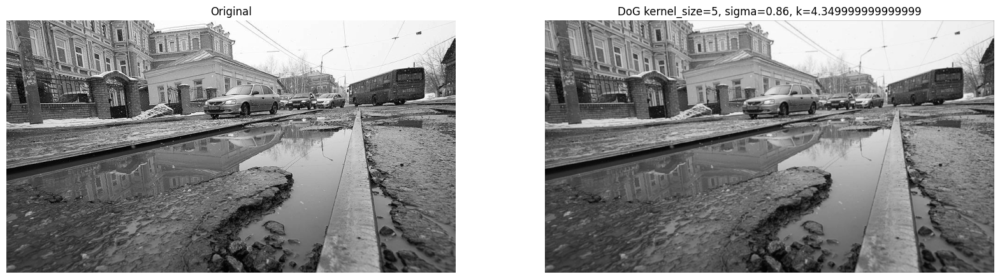

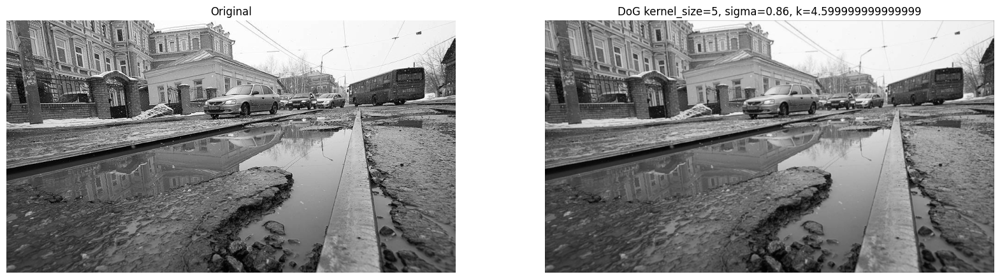

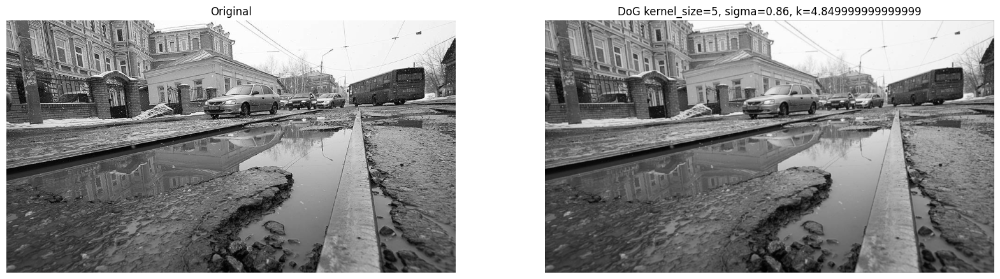

In [104]:
for k in np.arange(0.1, 5.1, 0.25):
    dog_image = difference_of_gaussians(img, sigma=0.86, k=k)
    show_images([img, dog_image], ['Original', f'DoG kernel_size=5, sigma=0.86, k={k}'])

DoG лучше всего при kernel_size=5, sigma=0.86, k=0.1

- Реализовать метод детектирования границ LoG (Laplassian of Gaussian) и DoG (Difference of Gaussians) для изображения, предварительно обработанного фильтром Гаусса (𝐼 𝑔𝑎𝑢𝑠𝑠).
- Обосновать выбор размера LoG (σ), которое будет оптимально для обнаружения блобов на изображении. Провести сравнение результатов для нескольких значений σ.
- Сравнить методы LoG и DoG между собой по качеству определения границ.
- Сделать выводы о том, какой метод (LoG или DoG) и какие параметры дают наилучшие результаты для данного изображения.